# View Fors2 , version short

- **Part 1**
- author : Sylvie Dagoret-Campagne
- affiliation : IJCLab/IN2P3/CNRS
- creation date : 2022/12/19
- update : 2022/12/20
- FORS2 : https://github.com/ericnuss/fors2
- Result of StarLight : /sps/lsst/groups/photoz/fors2/FORS2/ResStarlight



          /Users/dagoret/MacOSX/GitHub/LSST/FORS2>ls -l
              total 0
              drwxrwsr-x  3 dagoret  staff   96 Aug 21  2018 ResStarlight
              drwxr-xr-x  9 dagoret  staff  288 Dec 19 18:01 fors2

## Import

In [1]:
import os,sys,re
from astropy.io import fits
from astropy.table import Table

In [2]:
# Import some generally useful packages

import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cm as cmx

from matplotlib.backends.backend_pdf import PdfPages

%matplotlib inline
import pandas as pd
from itertools import cycle, islice


In [3]:
from scipy import ndimage

#from scipy import interp as scinterp
from scipy.interpolate import interp1d

import glob
import collections
#from def_raw_seds import *

In [4]:
# to enlarge the sizes
params = {'legend.fontsize': 'large',
          'figure.figsize': (8, 4),
         'axes.labelsize': 'xx-large',
         'axes.titlesize':'xx-large',
         'xtick.labelsize':'xx-large',
         'ytick.labelsize':'xx-large'}
plt.rcParams.update(params)

In [5]:
import matplotlib.offsetbox
props = dict(boxstyle='round',edgecolor="w",facecolor="w", alpha=0.5)

In [6]:
from def_raw_seds import *

In [7]:
from raw_data_analysis import *

In [8]:
# Import the primary photometry classes from rubin_sim.photUtils

import rubin_sim.photUtils.Bandpass as Bandpass
import rubin_sim.photUtils.Sed as Sed
from rubin_sim.data import get_data_dir

In [9]:
pysynphot_root_path=os.environ['PYSYN_CDBS']
path_sed_calspec=os.path.join(pysynphot_root_path,'calspec')
# pysynphot
import pysynphot as S
S.refs.setref(area=1)
S.refs.getref()

{'graphtable': '/Users/dagoret/MacOSX/External/PySynPhotData/grp/hst/cdbs/mtab/14l1632sm_tmg.fits',
 'comptable': '/Users/dagoret/MacOSX/External/PySynPhotData/grp/hst/cdbs/mtab/16n1832tm_tmc.fits',
 'thermtable': '/Users/dagoret/MacOSX/External/PySynPhotData/grp/hst/cdbs/mtab/tae17277m_tmt.fits',
 'area': 1,
 'waveset': 'Min: 500, Max: 26000, Num: 10000, Delta: None, Log: True'}

## Configuration

### Fors2

## Start

### Catalog

In [10]:
t = Table.read(filename_fits_catalog)

/Users/dagoret/anaconda3/lib/python3.9/site-packages/astropy/io/fits/connect.py:235: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask = data[col.name] == col.null


In [11]:
t

ID,m_ID,RAJ2000,DEJ2000,z,u_z,Rmag,RV,e_RV,RT,Nsp,Lines
,,deg,deg,,,mag,km / s,km / s,,,
int16,bytes1,float64,float64,float64,bytes1,float64,int32,int16,float64,int16,bytes77
1,,13.52815,-28.40486,0.55409,,20.79,166227,55,10.0,1,"[OII],H8,K,H"
2,,13.52997,-28.44776,0.34555,,21.18,103665,40,12.3,1,"K,H,G,H{beta}"
3,,13.52552,-28.4208,0.6866,,21.45,210642,48,11.6,4,"[OII],H9,K,H,H{beta},[OIII],H8"
4,,13.52216,-28.40914,0.68653,,21.62,205959,123,10.6,1,"[OII],H9,K,H,G,H{beta}"
7,,13.50974,-28.42972,0.32371,,22.34,97111,11,16.7,6,"[OII],H{beta},[OIII],H{alpha}"
9,,13.50219,-28.40641,0.29266,,21.6,87798,58,13.1,1,"H9,H8,K,H"
11,,13.49724,-28.39487,0.62688,,22.09,188063,17,24.3,3,"[OII],H10,H8,K,H,H{delta}"
12,,13.49584,-28.39125,0.2973,,21.97,89189,30,14.8,2,"[OII],H10,H9,H8,K,H"


### List

In [12]:
lst=fors2_jct_SL() #remet les spectres dans le rest frame (ie a z=0)

In [13]:
lst = sorted(lst)
print(lst)

['SPEC102', 'SPEC106', 'SPEC107', 'SPEC109', 'SPEC110', 'SPEC111', 'SPEC112', 'SPEC113', 'SPEC114', 'SPEC115', 'SPEC117', 'SPEC118', 'SPEC120', 'SPEC121', 'SPEC123', 'SPEC127', 'SPEC128', 'SPEC13', 'SPEC132', 'SPEC134', 'SPEC135', 'SPEC137', 'SPEC138', 'SPEC141', 'SPEC149', 'SPEC151', 'SPEC152', 'SPEC156', 'SPEC160', 'SPEC161', 'SPEC164', 'SPEC171', 'SPEC178', 'SPEC179', 'SPEC181', 'SPEC182', 'SPEC183', 'SPEC184', 'SPEC185', 'SPEC186', 'SPEC187', 'SPEC188', 'SPEC189', 'SPEC19', 'SPEC191', 'SPEC192', 'SPEC193', 'SPEC194', 'SPEC196', 'SPEC197', 'SPEC198', 'SPEC2', 'SPEC204', 'SPEC205', 'SPEC210', 'SPEC214', 'SPEC218', 'SPEC221', 'SPEC222', 'SPEC223', 'SPEC226', 'SPEC227', 'SPEC231', 'SPEC233', 'SPEC234', 'SPEC235', 'SPEC236', 'SPEC237', 'SPEC238', 'SPEC24', 'SPEC240', 'SPEC242', 'SPEC243', 'SPEC244', 'SPEC245', 'SPEC246', 'SPEC248', 'SPEC249', 'SPEC25', 'SPEC250', 'SPEC252', 'SPEC253', 'SPEC258', 'SPEC259', 'SPEC260', 'SPEC261', 'SPEC262', 'SPEC264', 'SPEC265', 'SPEC266', 'SPEC267', 'SPE

In [14]:
all_specfilenames = os.listdir(path_out_jct)

In [15]:
all_specfilenames = sorted(all_specfilenames)

In [16]:
all_numbers = [ int(re.findall('^SPEC(.*)[.]txt$',fn)[0]) for fn in all_specfilenames ]

In [17]:
all_numbers = sorted(all_numbers)

In [18]:
print(all_numbers)

[2, 3, 9, 13, 19, 24, 25, 30, 31, 32, 33, 34, 35, 36, 37, 45, 47, 49, 51, 55, 57, 58, 59, 61, 62, 66, 67, 68, 69, 70, 71, 72, 73, 77, 79, 80, 83, 84, 85, 86, 87, 89, 91, 93, 96, 97, 102, 106, 107, 109, 110, 111, 112, 113, 114, 115, 117, 118, 120, 121, 123, 127, 128, 132, 134, 135, 137, 138, 141, 149, 151, 152, 156, 160, 161, 164, 171, 178, 179, 181, 182, 183, 184, 185, 186, 187, 188, 189, 191, 192, 193, 194, 196, 197, 198, 204, 205, 210, 214, 218, 221, 222, 223, 226, 227, 231, 233, 234, 235, 236, 237, 238, 240, 242, 243, 244, 245, 246, 248, 249, 250, 252, 253, 258, 259, 260, 261, 262, 264, 265, 266, 267, 268, 271, 274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 287, 288, 291, 292, 294, 295, 296, 297, 298, 301, 302, 303, 304, 305, 306, 307, 308, 309, 313, 315, 317, 318, 319, 321, 322, 323, 324, 325, 326, 327, 328, 329, 331, 332, 333, 334, 335, 336, 337, 338, 339, 340, 341, 343, 344, 345, 346, 348, 349, 350, 351, 352, 353, 354, 355, 357, 358, 359, 360, 361, 362, 363, 364, 365, 366, 367

In [19]:
NSED = len(all_numbers)

# wavelength bin colors
jet = plt.get_cmap('jet')
cNorm = colors.Normalize(vmin=0, vmax=NSED)
scalarMap = cmx.ScalarMappable(norm=cNorm, cmap=jet)
all_colors = scalarMap.to_rgba(np.arange(NSED), alpha=1)

In [20]:
cut = t["ID"] == 3
t[cut]

ID,m_ID,RAJ2000,DEJ2000,z,u_z,Rmag,RV,e_RV,RT,Nsp,Lines
,,deg,deg,,,mag,km / s,km / s,,,
int16,bytes1,float64,float64,float64,bytes1,float64,int32,int16,float64,int16,bytes77
3,,13.52552,-28.4208,0.6866,,21.45,210642,48,11.6,4,"[OII],H9,K,H,H{beta},[OIII],H8"


In [21]:
t[cut]["z"].value[0]

0.6866

In [22]:
all_spectra = []
all_wl = []
all_tag = []
all_sed = []

for the_num in all_numbers:
    tcut = t["ID"] == the_num
    redshift = t[tcut]["z"].value[0]
    lines = t[tcut]["Lines"].value[0]
    filename = f"SPEC{the_num}.txt"
    tag = f"SPEC{the_num} , z={redshift:.2f}, lines={lines}"
    fullfilename = os.path.join(path_out_jct,filename)
    the_sed=SED_jct(the_num)
    all_sed.append(the_sed)
    arr = np.loadtxt(fullfilename)
    all_wl.append(arr[:,0])
    all_spectra.append(arr[:,1])
    all_tag.append(tag)
 

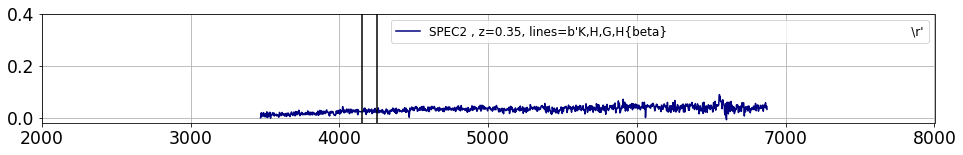

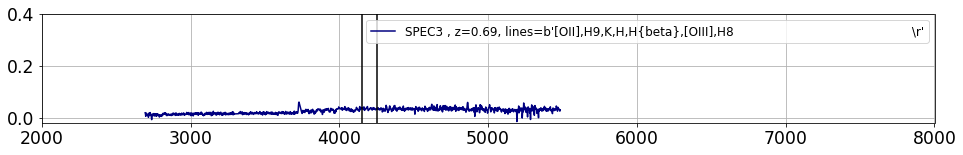

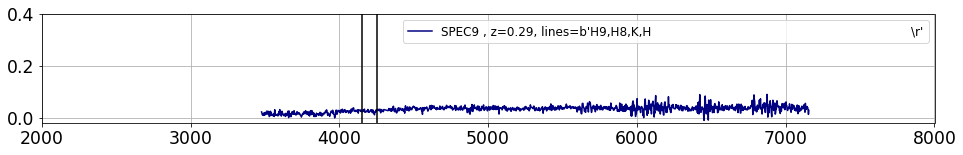

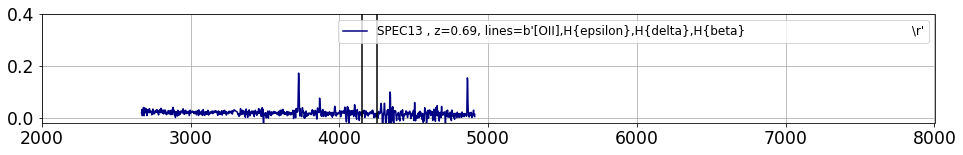

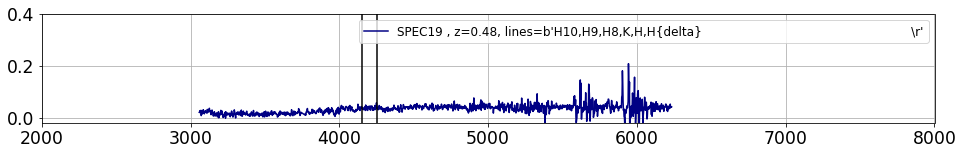

...

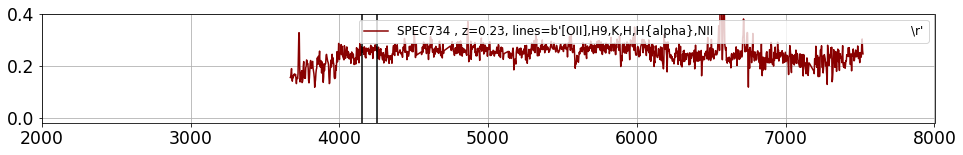

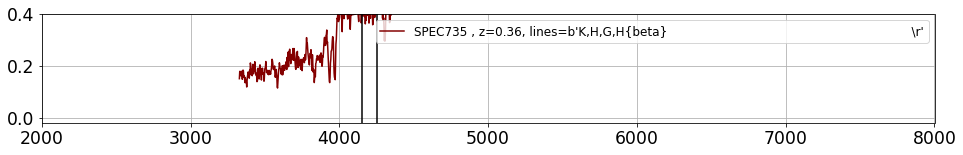

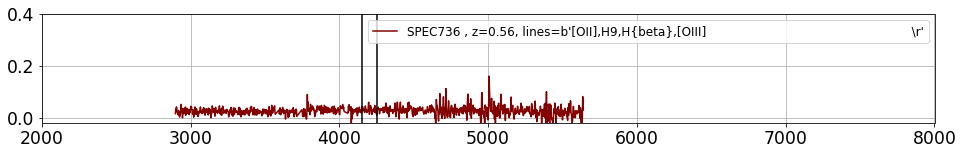

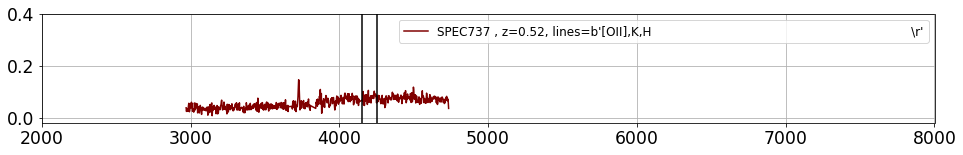

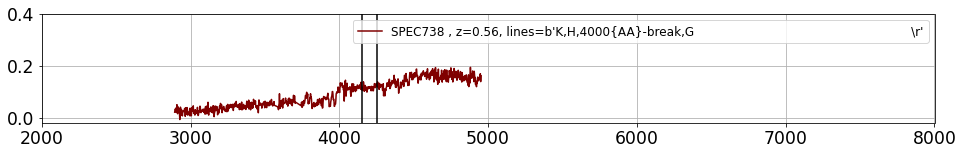

In [23]:
#plt.figure(figsize=(16,20))
for idx in range(NSED):
    plt.figure(figsize=(16,2))
    plt.plot(all_wl[idx],all_spectra[idx], color=all_colors[idx],label=all_tag[idx])
    plt.legend(loc="upper right")
    plt.grid()
    plt.axvline(4150,color="k")
    plt.axvline(4250,color="k")
    plt.ylim(-0.02,0.4)
    plt.xlim(2000.,8000.)
    plt.show()


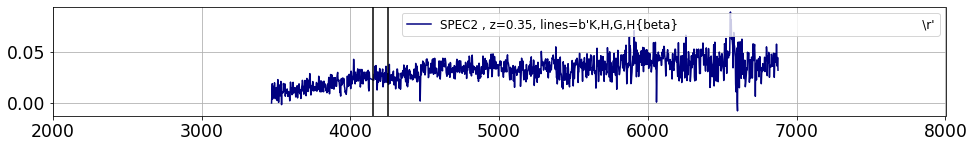

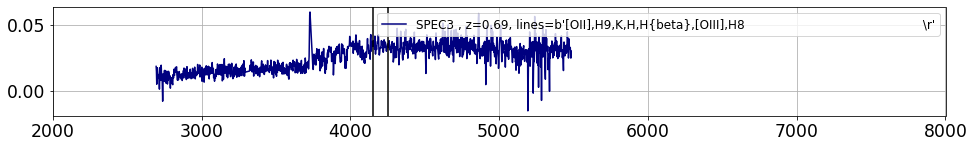

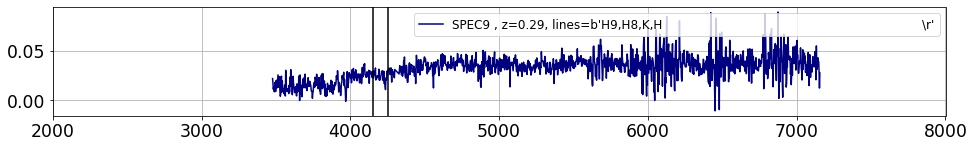

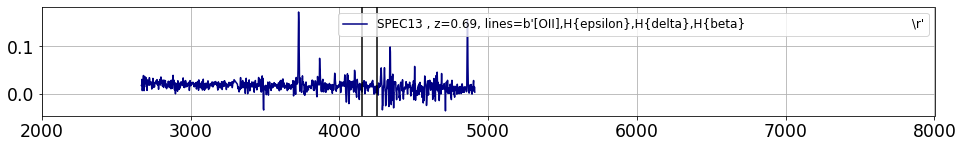

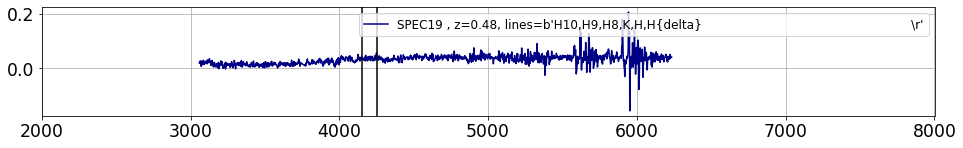

...

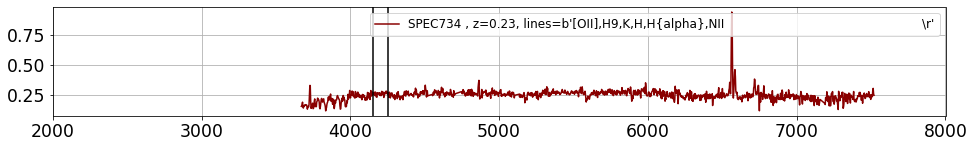

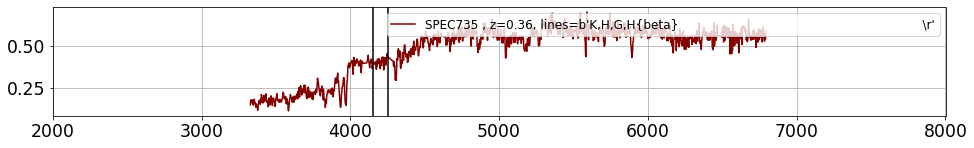

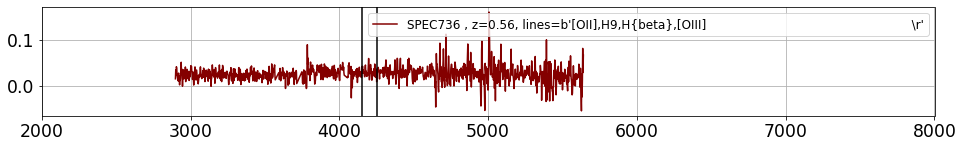

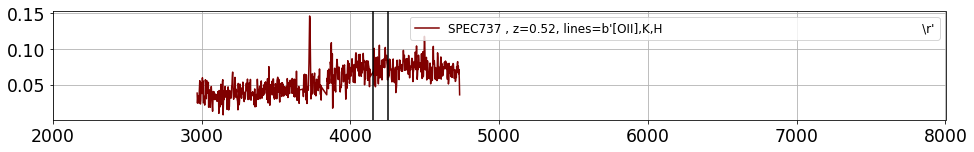

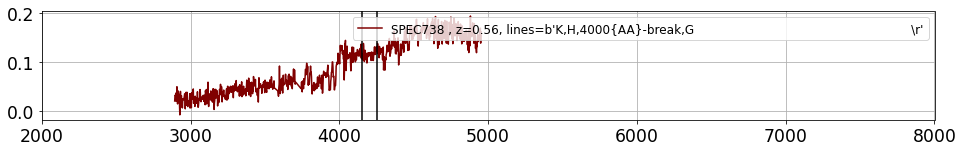

In [24]:
for index, the_sed in enumerate(all_sed):
    plt.figure(figsize=(16,2))
    
    the_label=all_tag[index]
    redshift= the_sed.z
    lines = the_sed.lines
    the_fulllabel = f"{the_label}, z ={redshift:.2f}, lines = {lines}"
        
    plt.plot(the_sed.wave,the_sed.flux, color=all_colors[index],label=the_label)
    plt.legend(loc="upper right")
    plt.grid()
    plt.axvline(4150,color="k")
    plt.axvline(4250,color="k")
    #plt.ylim(-0.02,0.4)
    plt.xlim(2000.,8000.)
    plt.show()